In [1]:
import warnings
warnings.filterwarnings(action='ignore')
%config Computer.use_jedi = False
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.unicode_minus'] = False
plt.rcParams['font.family'] = 'D2Coding'
plt.rcParams['font.size'] = 15
import seaborn as sns
from plotnine import *
import missingno as msno

영업 중인 전국 상가 업소 동향  
공공데이터포털(https://www.data.go.kr/)에서 '소상공인시장진흥공단' 검색

소상공인시장진흥공단_상가(상권)정보 중에서 서울과 부산 데이터만 읽어서 하나의 데이터프레임으로 만들어 csv 파일로 만들어 저장한다.

In [2]:
shop_2022_seoul = pd.read_csv('./data/shop_2022_seoul.csv')
print(shop_2022_seoul.shape)
shop_2022_seoul.head()

(489903, 39)


,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0037544,영자's곱창,NaN,I2,음식,I201,한식,I20109,곱창 전골/구이,I56111,...,1121510100101690021003140,NaN,서울특별시 광진구 면목로 172,143900,4904,NaN,1,NaN,127.082832,37.568503
1,MA0101202210A0097916,호텔클로이,NaN,I1,숙박,I101,일반 숙박,I10102,여관/모텔,I55102,...,1114014500101300000014092,유성장,서울특별시 중구 을지로42길 11,100411,4561,NaN,NaN,NaN,127.005849,37.565708
2,MA0101202210A0096343,나라차중계태권도장,NaN,P1,교육,P106,기타 교육,P10601,태권도/무술학원,P85611,...,1135010600103640019010971,삼부프라자,서울특별시 노원구 한글비석로 242,139861,1734,NaN,NaN,NaN,127.076956,37.649226
3,MA0101202210A0093845,이상한스냅,NaN,M1,과학·기술,M113,사진 촬영,M11301,사진촬영업,M73303,...,1147010300100090004000001,백송주택,서울특별시 양천구 월정로 283,158822,7902,NaN,NaN,NaN,126.828832,37.542117
4,MA010120220805430767,토끼정,NaN,I2,음식,I201,한식,I20101,백반/한정식,I56111,...,1150010500107740012000001,마커스빌딩,서울특별시 강서구 마곡동로 55,157805,7802,NaN,2,NaN,126.833022,37.560053


In [3]:
shop_2022_busan = pd.read_csv('./data/shop_2022_busan.csv')
print(shop_2022_busan.shape)
shop_2022_busan.head()

(377724, 39)


,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,23324279,제중건강원,NaN,D,소매,D10,건강/미용식품,D10A07,건강원,G47216,...,1156010600100410002034626,NaN,서울특별시 영등포구 영중로14길 11-17,150035,7250.0,NaN,1,NaN,126.907168,37.520613
1,24525909,민속악기사,NaN,D,소매,D04,취미/오락관련소매,D04A09,악기판매,G47593,...,1120012200101420011000227,NaN,서울특별시 성동구 용답5길 2,133849,4803.0,NaN,NaN,NaN,127.049018,37.566857
2,24715368,태평양진주,NaN,D,소매,D26,시계/귀금속소매,D26A01,시계/귀금속,G47830,...,1111015200100440000000001,금사랑투빌딩,서울특별시 종로구 서순라길 17-10,110390,3138.0,NaN,NaN,NaN,126.993530,37.571848
3,15554136,김선희꼼꼼국어교습소,NaN,R,학문/교육,R01,학원-보습교습입시,R01A01,학원-입시,P85501,...,1171011100101970003017195,NaN,서울특별시 송파구 위례성대로12길 31,138834,5640.0,NaN,2,NaN,127.121520,37.510967
4,17174175,비지트,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1165010100108540018009586,상랑의빌딩,서울특별시 서초구 동광로18길 82,137837,6572.0,NaN,1,NaN,126.991394,37.488375


In [4]:
shop_2022 = pd.concat([shop_2022_seoul, shop_2022_busan], axis=0, ignore_index=True)
shop_2022

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0037544,영자's곱창,NaN,I2,음식,I201,한식,I20109,곱창 전골/구이,I56111,...,1121510100101690021003140,NaN,서울특별시 광진구 면목로 172,143900,4904.0,NaN,1,NaN,127.082832,37.568503
1,MA0101202210A0097916,호텔클로이,NaN,I1,숙박,I101,일반 숙박,I10102,여관/모텔,I55102,...,1114014500101300000014092,유성장,서울특별시 중구 을지로42길 11,100411,4561.0,NaN,NaN,NaN,127.005849,37.565708
2,MA0101202210A0096343,나라차중계태권도장,NaN,P1,교육,P106,기타 교육,P10601,태권도/무술학원,P85611,...,1135010600103640019010971,삼부프라자,서울특별시 노원구 한글비석로 242,139861,1734.0,NaN,NaN,NaN,127.076956,37.649226
3,MA0101202210A0093845,이상한스냅,NaN,M1,과학·기술,M113,사진 촬영,M11301,사진촬영업,M73303,...,1147010300100090004000001,백송주택,서울특별시 양천구 월정로 283,158822,7902.0,NaN,NaN,NaN,126.828832,37.542117
4,MA010120220805430767,토끼정,NaN,I2,음식,I201,한식,I20101,백반/한정식,I56111,...,1150010500107740012000001,마커스빌딩,서울특별시 강서구 마곡동로 55,157805,7802.0,NaN,2,NaN,126.833022,37.560053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867622,19079387,향나무참숯장어나라,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1138010600100260008026739,NaN,서울특별시 은평구 진흥로 153-4,122837,3396.0,NaN,1,NaN,126.926643,37.609327
867623,19079580,에이치에스컨설팅,NaN,L,부동산,L01,부동산중개,L01A01,부동산중개,L68221,...,1132010600106960040003438,NaN,서울특별시 도봉구 방학로6길 38,132852,1342.0,NaN,3,NaN,127.036563,37.664572
867624,19079781,크린에이드,가양역점,F,생활서비스,F02,세탁/가사서비스,F02A01,세탁소/빨래방,S96912,...,1150010400100140003009639,가양우성아파트,서울특별시 강서구 양천로 489,157750,7526.0,상가,1,NaN,126.854188,37.562234
867625,19080385,멍,NaN,D,소매,D09,애견/애완/동물,D09A02,애완동물 미용실,S96995,...,1132010700105810012017146,NaN,서울특별시 도봉구 덕릉로59길 15,132918,1470.0,NaN,NaN,NaN,127.038608,37.640459


In [5]:
# 서울과 부산 데이터만 읽어서 하나의 데이터프레임으로 만든 데이터를 csv 파일로 저장한다.
# csv 파일로 저장할 때 인덱스를 제외하고 저장하려면 index=None 옵션을 사용한다.
shop_2022.to_csv('./data/shop_2022.csv', index=None)

In [6]:
# 파이썬은 java 처럼 {} 블록이 없어서 사용한 변수가 자동으로 삭제되지 않기때문에 계속 메모리를 차지하는 문제가 발생될 수 있으므로
# del 명령을 실행해서 사용하지 않는 변수는 메모리에서 삭제한다.
del shop_2022_seoul, shop_2022_busan

서울과 부산 데이터만 읽어서 하나의 데이터프레임으로 만들어 저장한 csv 파일을 읽어들인다.

In [7]:
shop_2022 = pd.read_csv('./data/shop_2022.csv')
shop_2022

,상가업소번호,상호명,지점명,상권업종대분류코드,상권업종대분류명,상권업종중분류코드,상권업종중분류명,상권업종소분류코드,상권업종소분류명,표준산업분류코드,...,건물관리번호,건물명,도로명주소,구우편번호,신우편번호,동정보,층정보,호정보,경도,위도
0,MA0101202210A0037544,영자's곱창,NaN,I2,음식,I201,한식,I20109,곱창 전골/구이,I56111,...,1121510100101690021003140,NaN,서울특별시 광진구 면목로 172,143900,4904.0,NaN,1,NaN,127.082832,37.568503
1,MA0101202210A0097916,호텔클로이,NaN,I1,숙박,I101,일반 숙박,I10102,여관/모텔,I55102,...,1114014500101300000014092,유성장,서울특별시 중구 을지로42길 11,100411,4561.0,NaN,NaN,NaN,127.005849,37.565708
2,MA0101202210A0096343,나라차중계태권도장,NaN,P1,교육,P106,기타 교육,P10601,태권도/무술학원,P85611,...,1135010600103640019010971,삼부프라자,서울특별시 노원구 한글비석로 242,139861,1734.0,NaN,NaN,NaN,127.076956,37.649226
3,MA0101202210A0093845,이상한스냅,NaN,M1,과학·기술,M113,사진 촬영,M11301,사진촬영업,M73303,...,1147010300100090004000001,백송주택,서울특별시 양천구 월정로 283,158822,7902.0,NaN,NaN,NaN,126.828832,37.542117
4,MA010120220805430767,토끼정,NaN,I2,음식,I201,한식,I20101,백반/한정식,I56111,...,1150010500107740012000001,마커스빌딩,서울특별시 강서구 마곡동로 55,157805,7802.0,NaN,2,NaN,126.833022,37.560053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867622,19079387,향나무참숯장어나라,NaN,Q,음식,Q01,한식,Q01A01,한식/백반/한정식,I56111,...,1138010600100260008026739,NaN,서울특별시 은평구 진흥로 153-4,122837,3396.0,NaN,1,NaN,126.926643,37.609327
867623,19079580,에이치에스컨설팅,NaN,L,부동산,L01,부동산중개,L01A01,부동산중개,L68221,...,1132010600106960040003438,NaN,서울특별시 도봉구 방학로6길 38,132852,1342.0,NaN,3,NaN,127.036563,37.664572
867624,19079781,크린에이드,가양역점,F,생활서비스,F02,세탁/가사서비스,F02A01,세탁소/빨래방,S96912,...,1150010400100140003009639,가양우성아파트,서울특별시 강서구 양천로 489,157750,7526.0,상가,1,NaN,126.854188,37.562234
867625,19080385,멍,NaN,D,소매,D09,애견/애완/동물,D09A02,애완동물 미용실,S96995,...,1132010700105810012017146,NaN,서울특별시 도봉구 덕릉로59길 15,132918,1470.0,NaN,NaN,NaN,127.038608,37.640459


분석 작업에 불필요한 컬럼을 삭제한다.

In [8]:
shop_2022.columns

Index(['상가업소번호', '상호명', '지점명', '상권업종대분류코드', '상권업종대분류명', '상권업종중분류코드',
       '상권업종중분류명', '상권업종소분류코드', '상권업종소분류명', '표준산업분류코드', '표준산업분류명', '시도코드',
       '시도명', '시군구코드', '시군구명', '행정동코드', '행정동명', '법정동코드', '법정동명', '지번코드',
       '대지구분코드', '대지구분명', '지번본번지', '지번부번지', '지번주소', '도로명코드', '도로명', '건물본번지',
       '건물부번지', '건물관리번호', '건물명', '도로명주소', '구우편번호', '신우편번호', '동정보', '층정보',
       '호정보', '경도', '위도'],
      dtype='object')

In [9]:
# drop() 메소드로 불필요한 컬럼을 삭제한다. => 원본 데이터가 손상된다.
# drop() 메소드는 axis=0이 기본값이므로 axis를 생략하면 행 방향 데이터를 제거하려 하기 때문에 에러가 발생되므로
# axis 옵션 값을 1로 지정해서 컬럼을 삭제한다.
# shop_2022 = shop_2022.drop('층정보') # 에러
# shop_2022 = shop_2022.drop('층정보', axis=1)
# 1개의 컬럼을 삭제하려면 삭제할 컬럼의 이름만 쓰면 되지만 2개 이상의 컬럼을 제거하려면 삭제할 컬럼을 리스트로 묶는다.
shop_2022.drop(['동정보', '호정보'], axis=1, inplace=True)
shop_2022.columns

Index(['상가업소번호', '상호명', '지점명', '상권업종대분류코드', '상권업종대분류명', '상권업종중분류코드',
       '상권업종중분류명', '상권업종소분류코드', '상권업종소분류명', '표준산업분류코드', '표준산업분류명', '시도코드',
       '시도명', '시군구코드', '시군구명', '행정동코드', '행정동명', '법정동코드', '법정동명', '지번코드',
       '대지구분코드', '대지구분명', '지번본번지', '지번부번지', '지번주소', '도로명코드', '도로명', '건물본번지',
       '건물부번지', '건물관리번호', '건물명', '도로명주소', '구우편번호', '신우편번호', '층정보', '경도', '위도'],
      dtype='object')

분석 작업에 필요한 컬럼만 추려낸다.

In [10]:
shop_2022.isnull().sum()

상가업소번호            0
상호명               0
지점명          798376
상권업종대분류코드         0
상권업종대분류명          0
상권업종중분류코드         0
상권업종중분류명          0
상권업종소분류코드         0
상권업종소분류명          0
표준산업분류코드      26251
표준산업분류명       26251
시도코드              0
시도명               0
시군구코드             0
시군구명              0
행정동코드             0
행정동명              0
법정동코드             0
법정동명              0
지번코드              0
대지구분코드            0
대지구분명             0
지번본번지             0
지번부번지        158767
지번주소              0
도로명코드             0
도로명               0
건물본번지             1
건물부번지        752630
건물관리번호            4
건물명          447580
도로명주소             0
구우편번호             0
신우편번호            36
층정보          297343
경도                0
위도                0
dtype: int64

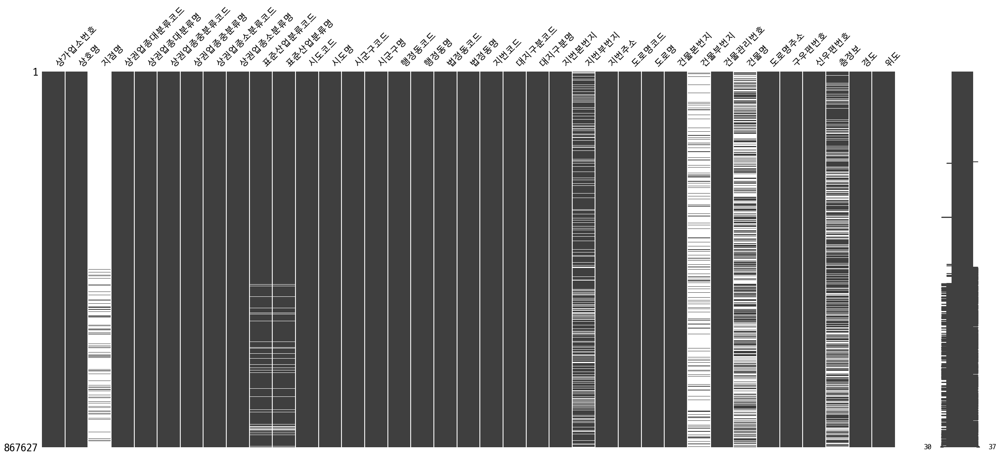

In [11]:
msno.matrix(shop_2022, figsize=(30, 12))
plt.show()

In [12]:
value_colunms = ['상호명', '지점명', '상권업종대분류명', '상권업종중분류명', '상권업종소분류명', '시도명', '시군구명', 
                 '행정동명', '법정동명', '지번주소', '도로명주소', '경도', '위도']
shop_202212 = shop_2022[value_colunms]
shop_202212

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도
0,영자's곱창,NaN,음식,한식,곱창 전골/구이,서울특별시,광진구,중곡3동,중곡동,서울특별시 광진구 중곡동 169-21,서울특별시 광진구 면목로 172,127.082832,37.568503
1,호텔클로이,NaN,숙박,일반 숙박,여관/모텔,서울특별시,중구,광희동,광희동1가,서울특별시 중구 광희동1가 130,서울특별시 중구 을지로42길 11,127.005849,37.565708
2,나라차중계태권도장,NaN,교육,기타 교육,태권도/무술학원,서울특별시,노원구,중계본동,중계동,서울특별시 노원구 중계동 364-19,서울특별시 노원구 한글비석로 242,127.076956,37.649226
3,이상한스냅,NaN,과학·기술,사진 촬영,사진촬영업,서울특별시,양천구,신월5동,신월동,서울특별시 양천구 신월동 9-4,서울특별시 양천구 월정로 283,126.828832,37.542117
4,토끼정,NaN,음식,한식,백반/한정식,서울특별시,강서구,가양1동,마곡동,서울특별시 강서구 마곡동 774-12,서울특별시 강서구 마곡동로 55,126.833022,37.560053
...,...,...,...,...,...,...,...,...,...,...,...,...,...
867622,향나무참숯장어나라,NaN,음식,한식,한식/백반/한정식,서울특별시,은평구,대조동,대조동,서울특별시 은평구 대조동 26-8,서울특별시 은평구 진흥로 153-4,126.926643,37.609327
867623,에이치에스컨설팅,NaN,부동산,부동산중개,부동산중개,서울특별시,도봉구,방학1동,방학동,서울특별시 도봉구 방학동 696-40,서울특별시 도봉구 방학로6길 38,127.036563,37.664572
867624,크린에이드,가양역점,생활서비스,세탁/가사서비스,세탁소/빨래방,서울특별시,강서구,가양2동,가양동,서울특별시 강서구 가양동 14-3,서울특별시 강서구 양천로 489,126.854188,37.562234
867625,멍,NaN,소매,애견/애완/동물,애완동물 미용실,서울특별시,도봉구,창2동,창동,서울특별시 도봉구 창동 581-12,서울특별시 도봉구 덕릉로59길 15,127.038608,37.640459


In [13]:
del shop_2022

In [14]:
shop_202212.isnull().sum()

상호명              0
지점명         798376
상권업종대분류명         0
상권업종중분류명         0
상권업종소분류명         0
시도명              0
시군구명             0
행정동명             0
법정동명             0
지번주소             0
도로명주소            0
경도               0
위도               0
dtype: int64

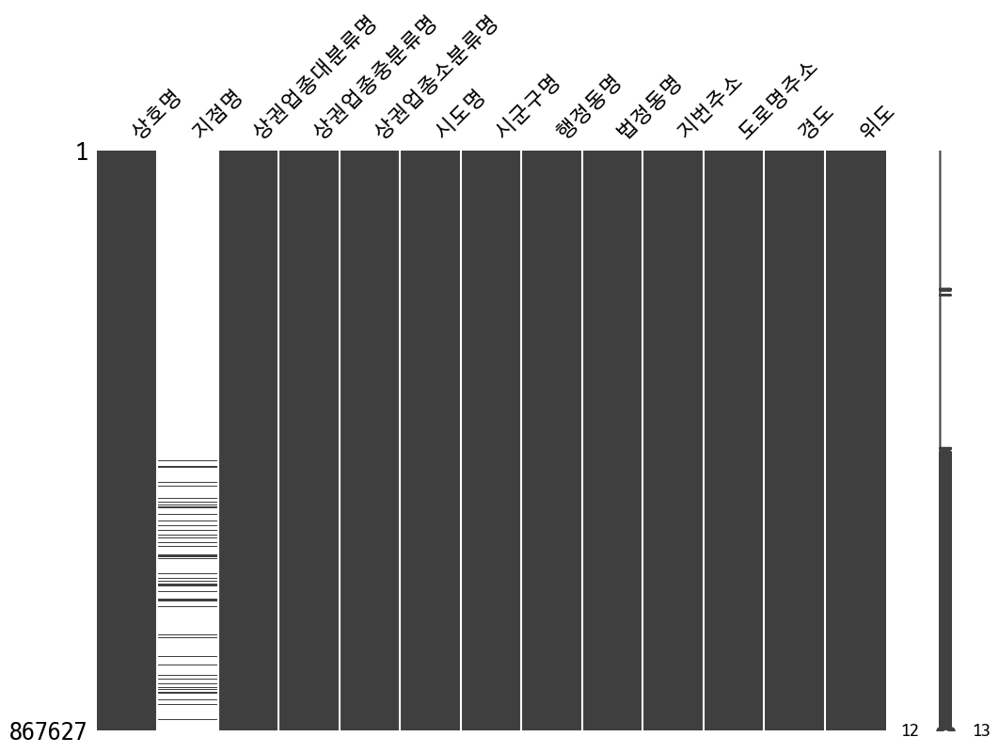

In [15]:
msno.matrix(shop_202212, figsize=(12, 8))
plt.show()

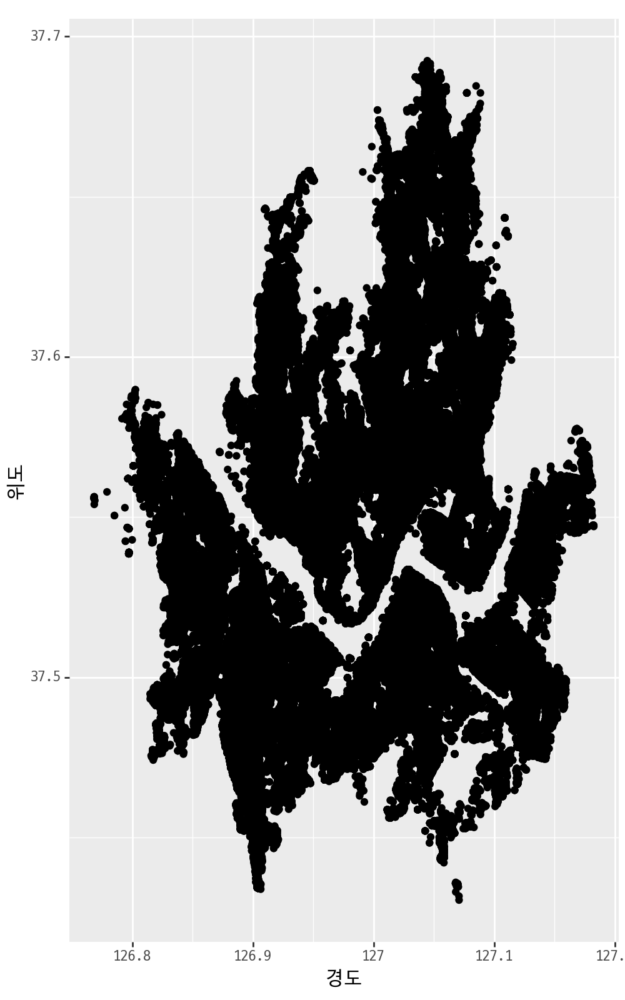

<Figure Size: (500 x 800)>

In [16]:
(
    ggplot(shop_202212, aes(x='경도', y='위도'))
        + geom_point()
        + theme(text=element_text(family='D2Coding'), figure_size=(5, 8))
)

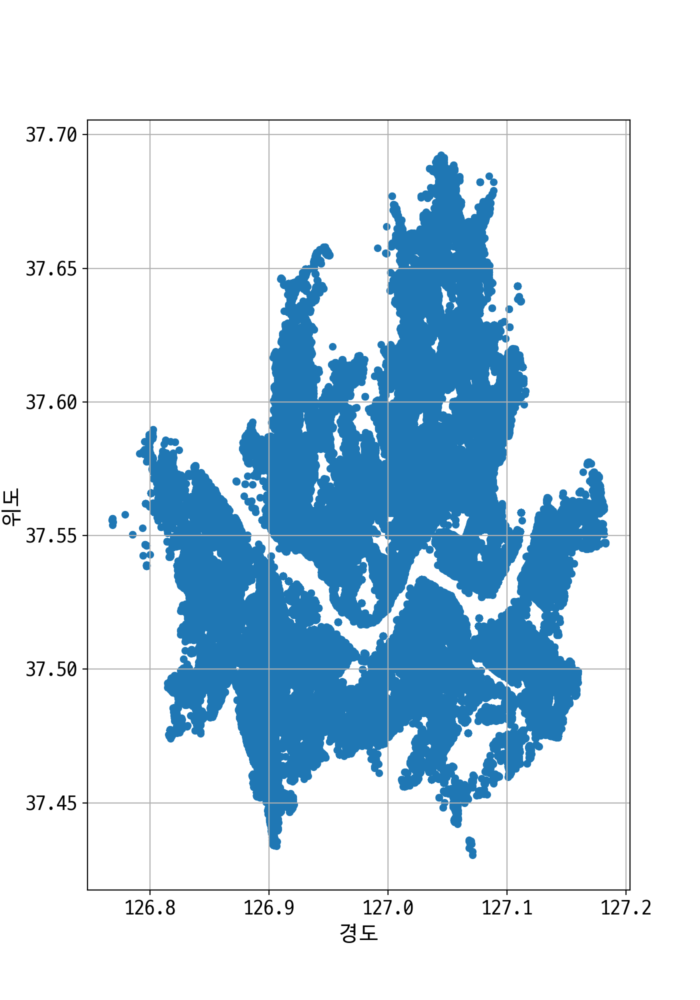

In [17]:
shop_202212.plot.scatter(x='경도', y='위도', figsize=(7, 10), grid=True)
plt.show()

데이터프레임에서 서울 데이터만 추출한다.

In [18]:
# 시도명 열에 '서울특별시'라고만 입력이 되어있다면 아래와 같이 실행하면 된다.
# shop_202212[shop_202212['시도명'] == '서울특별시']
# shop_202212.loc[shop_202212['시도명'] == '서울특별시']

# 시도명 열에 '서울특별시', '서울', '서울시'와 같이 입력값이 혼재되어 있다면 아래와 같이 논리 연산을 실행해야 한다.
# 판다스에서 불린 인뎅싱시 and 조건은 '&'를 사용하고 or 조건은 '|'를 사용한다.
# and, or 조건 지정시 관계 연산자가 사용된(브로드캐스팅이 실행되는) 부분을 반드시 ()로 묶어야 한다.
# shop_202212[(shop_202212['시도명'] == '서울특별시') | (shop_202212['시도명'] == '서울') | (shop_202212['시도명'] == '서울시')]

# 시도명열 또는 지번주소열 또는 도로명주소열의 입력값의 앞 2글자가 '서울'인 데이터를 얻어온다.
# shop_202212[shop_202212.시도명.str[:2] == '서울']
# shop_202212[shop_202212.지번주소.str[:2] == '서울']
# shop_202212[shop_202212.도로명주소.str[:2] == '서울']
# 시도명열 또는 지번주소열 또는 도로명주소열의 입력값에 '서울'이 포함된 데이터를 얻어온다.
# shop_202212[shop_202212.시도명.str.find('서울') >= 0]
# shop_202212[shop_202212.시도명.str.count('서울') >= 1]

# 시도명열 또는 지번주소열 또는 도로명주소열의 입력값이 '서울'로 시작하는 데이터를 얻어온다.
# startswith() 메소드는 인수로 지정된 문자열로 시작하면 True, 그렇치 않으면 False를 리턴한다.
# endswith() 메소드는 인수로 지정된 문자열로 끝나면 True, 그렇치 않으면 False를 리턴한다.
shop_seoul = shop_202212[shop_202212.시도명.str.startswith('서울')]
shop_seoul

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도
0,영자's곱창,NaN,음식,한식,곱창 전골/구이,서울특별시,광진구,중곡3동,중곡동,서울특별시 광진구 중곡동 169-21,서울특별시 광진구 면목로 172,127.082832,37.568503
1,호텔클로이,NaN,숙박,일반 숙박,여관/모텔,서울특별시,중구,광희동,광희동1가,서울특별시 중구 광희동1가 130,서울특별시 중구 을지로42길 11,127.005849,37.565708
2,나라차중계태권도장,NaN,교육,기타 교육,태권도/무술학원,서울특별시,노원구,중계본동,중계동,서울특별시 노원구 중계동 364-19,서울특별시 노원구 한글비석로 242,127.076956,37.649226
3,이상한스냅,NaN,과학·기술,사진 촬영,사진촬영업,서울특별시,양천구,신월5동,신월동,서울특별시 양천구 신월동 9-4,서울특별시 양천구 월정로 283,126.828832,37.542117
4,토끼정,NaN,음식,한식,백반/한정식,서울특별시,강서구,가양1동,마곡동,서울특별시 강서구 마곡동 774-12,서울특별시 강서구 마곡동로 55,126.833022,37.560053
...,...,...,...,...,...,...,...,...,...,...,...,...,...
867622,향나무참숯장어나라,NaN,음식,한식,한식/백반/한정식,서울특별시,은평구,대조동,대조동,서울특별시 은평구 대조동 26-8,서울특별시 은평구 진흥로 153-4,126.926643,37.609327
867623,에이치에스컨설팅,NaN,부동산,부동산중개,부동산중개,서울특별시,도봉구,방학1동,방학동,서울특별시 도봉구 방학동 696-40,서울특별시 도봉구 방학로6길 38,127.036563,37.664572
867624,크린에이드,가양역점,생활서비스,세탁/가사서비스,세탁소/빨래방,서울특별시,강서구,가양2동,가양동,서울특별시 강서구 가양동 14-3,서울특별시 강서구 양천로 489,126.854188,37.562234
867625,멍,NaN,소매,애견/애완/동물,애완동물 미용실,서울특별시,도봉구,창2동,창동,서울특별시 도봉구 창동 581-12,서울특별시 도봉구 덕릉로59길 15,127.038608,37.640459


In [19]:
# '~'는 ~가 아닌것을 의미한다. => 논리부정, not 연산자
shop_expect_seoul = shop_202212[~shop_202212.시도명.str.startswith('서울')]
shop_expect_seoul

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도


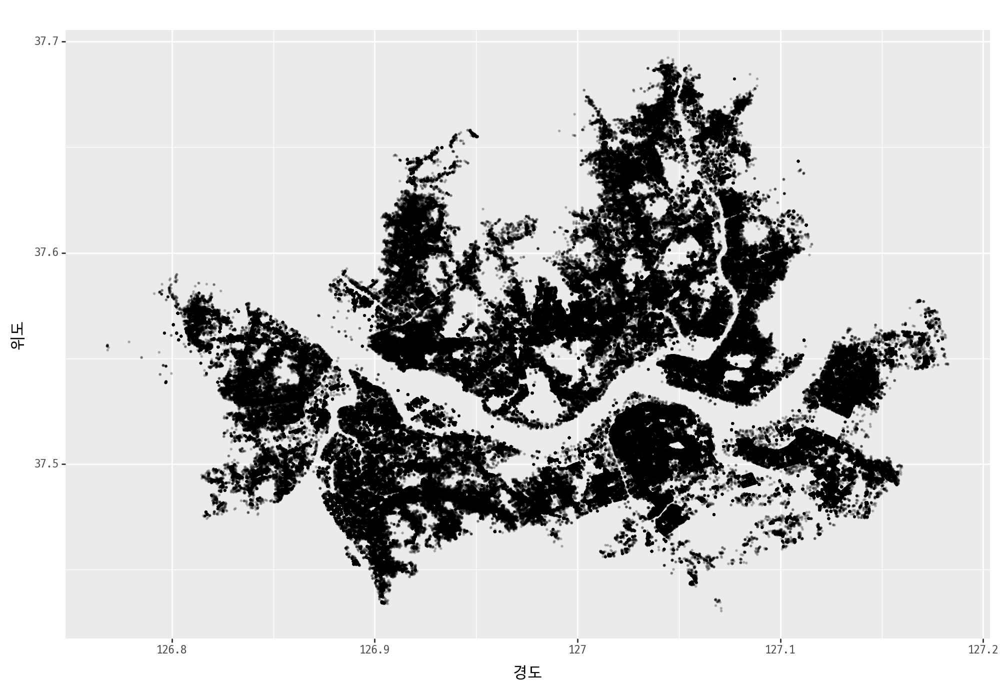

<Figure Size: (1000 x 700)>

In [20]:
# 서울만 시각화해보면 서울 지도하고 비슷하게 나온다.
(
    ggplot(shop_seoul, aes(x='경도', y='위도'))
        + geom_point(size=0.2, alpha=0.2)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
)

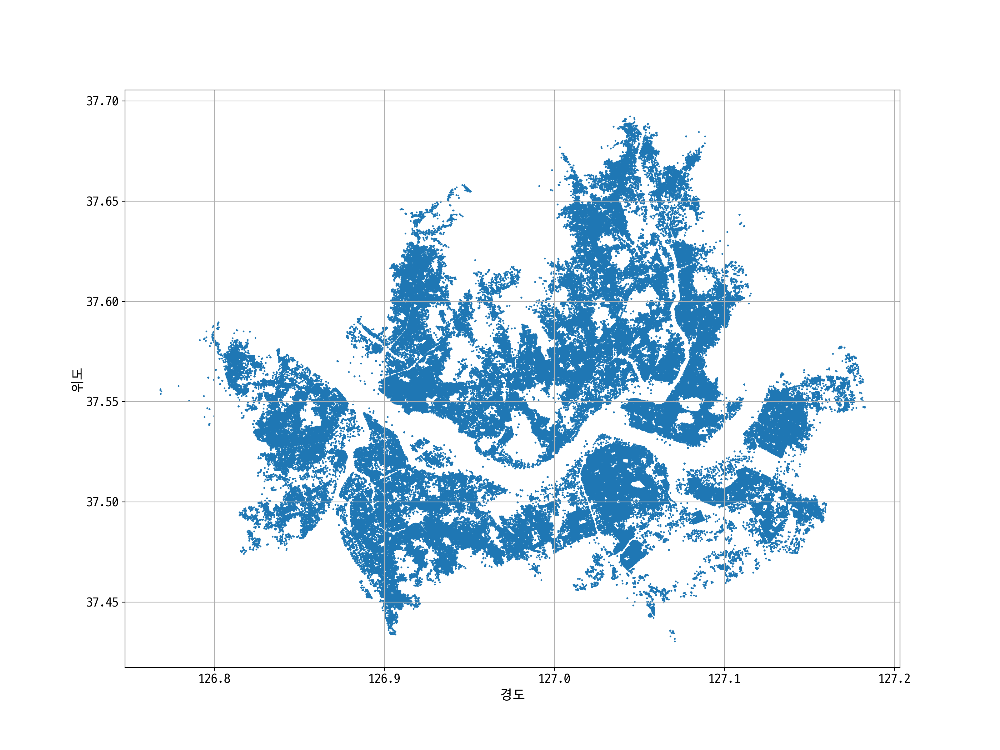

In [21]:
shop_seoul.plot.scatter(x='경도', y='위도', figsize=(16, 12), grid=True, s=1)
plt.show()

shop_202212 데이터프레임의 도로명주소 열을 활용해서 '시도', '구군', '도로명' 열을 만든다.

In [22]:
# split() 메소드에 expand=True 옵션을 지정해서 공백을 경계로 문자열을 서로 다른 열(데이터프레임)로 구분해서
# '시도', '구군', '도로명'열을 만든다.
# print(type(shop_202212[:1].도로명주소)) # <class 'pandas.core.series.Series'>
print(shop_202212[:1].도로명주소)
# print(type(shop_202212[:1].도로명주소.str)) # <class 'pandas.core.strings.StringMethods'>
print(shop_202212[:1].도로명주소.str)
# print(type(shop_202212[:1].도로명주소.str.split(' '))) # <class 'pandas.core.series.Series'>
print(shop_202212[:1].도로명주소.str.split(' '))
print('=' * 80)
print(type(shop_202212[:1].도로명주소.str.split(' ', expand=True)))
print(shop_202212[:1].도로명주소.str.split(' ', expand=True))
print('=' * 80)
print(shop_202212[:1].도로명주소.str.split(' ', expand=True)[0])
print(shop_202212[:1].도로명주소.str.split(' ', expand=True)[1])
print(shop_202212[:1].도로명주소.str.split(' ', expand=True)[2])
print(shop_202212[:1].도로명주소.str.split(' ', expand=True)[3])

0    서울특별시 광진구 면목로 172
Name: 도로명주소, dtype: object
0    [서울특별시, 광진구, 면목로, 172]
Name: 도로명주소, dtype: object
<class 'pandas.core.frame.DataFrame'>
       0    1    2    3
0  서울특별시  광진구  면목로  172
0    서울특별시
Name: 0, dtype: object
0    광진구
Name: 1, dtype: object
0    면목로
Name: 2, dtype: object
0    172
Name: 3, dtype: object


In [23]:
shop_202212['시도'] = shop_202212.도로명주소.str.split(' ', expand=True)[0]
shop_202212['구군'] = shop_202212.도로명주소.str.split(' ', expand=True)[1]
shop_202212['도로명'] = shop_202212.도로명주소.str.split(' ', expand=True)[2]
shop_202212

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도,시도,구군,도로명
0,영자's곱창,NaN,음식,한식,곱창 전골/구이,서울특별시,광진구,중곡3동,중곡동,서울특별시 광진구 중곡동 169-21,서울특별시 광진구 면목로 172,127.082832,37.568503,서울특별시,광진구,면목로
1,호텔클로이,NaN,숙박,일반 숙박,여관/모텔,서울특별시,중구,광희동,광희동1가,서울특별시 중구 광희동1가 130,서울특별시 중구 을지로42길 11,127.005849,37.565708,서울특별시,중구,을지로42길
2,나라차중계태권도장,NaN,교육,기타 교육,태권도/무술학원,서울특별시,노원구,중계본동,중계동,서울특별시 노원구 중계동 364-19,서울특별시 노원구 한글비석로 242,127.076956,37.649226,서울특별시,노원구,한글비석로
3,이상한스냅,NaN,과학·기술,사진 촬영,사진촬영업,서울특별시,양천구,신월5동,신월동,서울특별시 양천구 신월동 9-4,서울특별시 양천구 월정로 283,126.828832,37.542117,서울특별시,양천구,월정로
4,토끼정,NaN,음식,한식,백반/한정식,서울특별시,강서구,가양1동,마곡동,서울특별시 강서구 마곡동 774-12,서울특별시 강서구 마곡동로 55,126.833022,37.560053,서울특별시,강서구,마곡동로
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867622,향나무참숯장어나라,NaN,음식,한식,한식/백반/한정식,서울특별시,은평구,대조동,대조동,서울특별시 은평구 대조동 26-8,서울특별시 은평구 진흥로 153-4,126.926643,37.609327,서울특별시,은평구,진흥로
867623,에이치에스컨설팅,NaN,부동산,부동산중개,부동산중개,서울특별시,도봉구,방학1동,방학동,서울특별시 도봉구 방학동 696-40,서울특별시 도봉구 방학로6길 38,127.036563,37.664572,서울특별시,도봉구,방학로6길
867624,크린에이드,가양역점,생활서비스,세탁/가사서비스,세탁소/빨래방,서울특별시,강서구,가양2동,가양동,서울특별시 강서구 가양동 14-3,서울특별시 강서구 양천로 489,126.854188,37.562234,서울특별시,강서구,양천로
867625,멍,NaN,소매,애견/애완/동물,애완동물 미용실,서울특별시,도봉구,창2동,창동,서울특별시 도봉구 창동 581-12,서울특별시 도봉구 덕릉로59길 15,127.038608,37.640459,서울특별시,도봉구,덕릉로59길


In [24]:
# '시도', '구군', '도로명' 열이 추가된 원본 데이터프레임(shop_202212)에서 서울만 다시 추출한다.
shop_seoul = shop_202212[shop_202212.시도명.str.startswith('서울')]
shop_seoul

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도,시도,구군,도로명
0,영자's곱창,NaN,음식,한식,곱창 전골/구이,서울특별시,광진구,중곡3동,중곡동,서울특별시 광진구 중곡동 169-21,서울특별시 광진구 면목로 172,127.082832,37.568503,서울특별시,광진구,면목로
1,호텔클로이,NaN,숙박,일반 숙박,여관/모텔,서울특별시,중구,광희동,광희동1가,서울특별시 중구 광희동1가 130,서울특별시 중구 을지로42길 11,127.005849,37.565708,서울특별시,중구,을지로42길
2,나라차중계태권도장,NaN,교육,기타 교육,태권도/무술학원,서울특별시,노원구,중계본동,중계동,서울특별시 노원구 중계동 364-19,서울특별시 노원구 한글비석로 242,127.076956,37.649226,서울특별시,노원구,한글비석로
3,이상한스냅,NaN,과학·기술,사진 촬영,사진촬영업,서울특별시,양천구,신월5동,신월동,서울특별시 양천구 신월동 9-4,서울특별시 양천구 월정로 283,126.828832,37.542117,서울특별시,양천구,월정로
4,토끼정,NaN,음식,한식,백반/한정식,서울특별시,강서구,가양1동,마곡동,서울특별시 강서구 마곡동 774-12,서울특별시 강서구 마곡동로 55,126.833022,37.560053,서울특별시,강서구,마곡동로
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867622,향나무참숯장어나라,NaN,음식,한식,한식/백반/한정식,서울특별시,은평구,대조동,대조동,서울특별시 은평구 대조동 26-8,서울특별시 은평구 진흥로 153-4,126.926643,37.609327,서울특별시,은평구,진흥로
867623,에이치에스컨설팅,NaN,부동산,부동산중개,부동산중개,서울특별시,도봉구,방학1동,방학동,서울특별시 도봉구 방학동 696-40,서울특별시 도봉구 방학로6길 38,127.036563,37.664572,서울특별시,도봉구,방학로6길
867624,크린에이드,가양역점,생활서비스,세탁/가사서비스,세탁소/빨래방,서울특별시,강서구,가양2동,가양동,서울특별시 강서구 가양동 14-3,서울특별시 강서구 양천로 489,126.854188,37.562234,서울특별시,강서구,양천로
867625,멍,NaN,소매,애견/애완/동물,애완동물 미용실,서울특별시,도봉구,창2동,창동,서울특별시 도봉구 창동 581-12,서울특별시 도봉구 덕릉로59길 15,127.038608,37.640459,서울특별시,도봉구,덕릉로59길


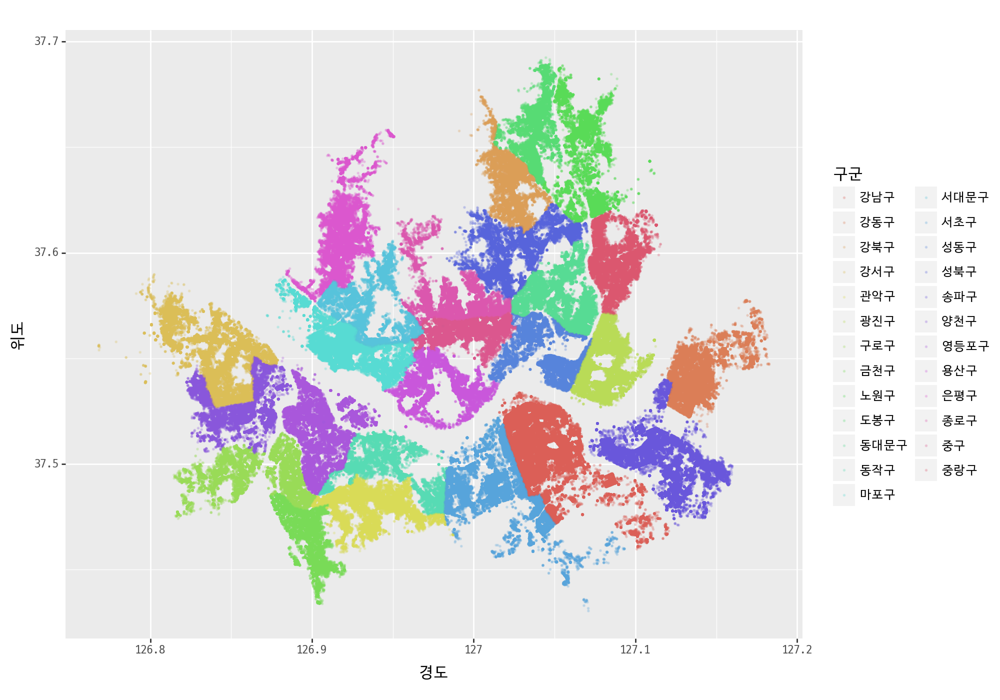

<Figure Size: (1000 x 700)>

In [25]:
(
    ggplot(shop_seoul, aes(x='경도', y='위도', color='구군'))
        + geom_point(size=0.2, alpha=0.2)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
)

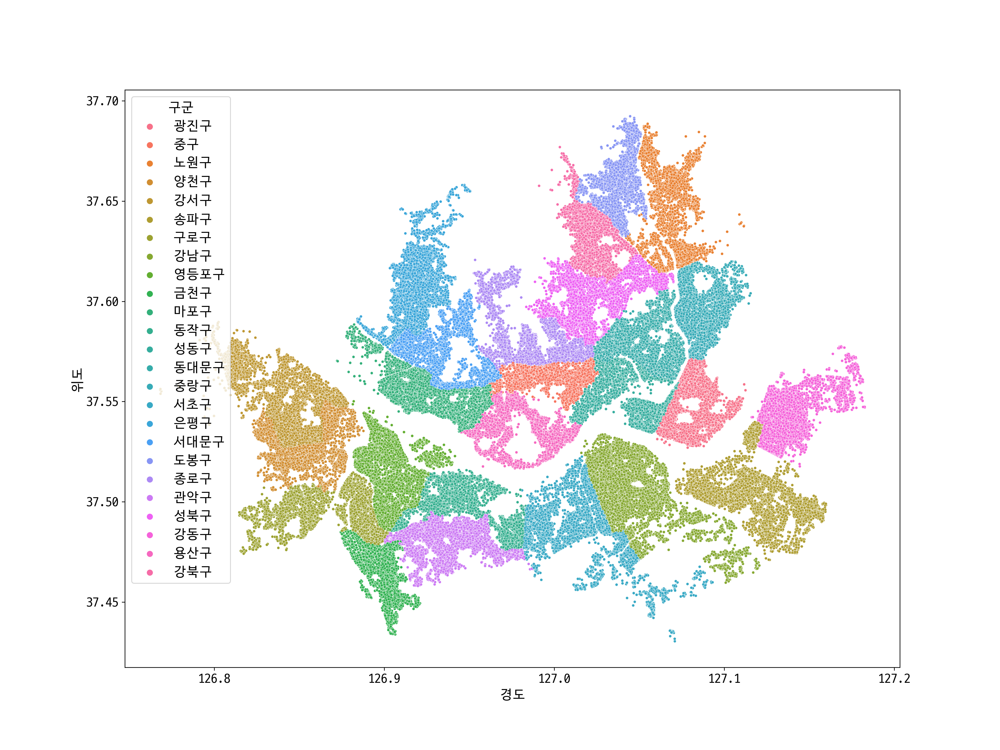

In [26]:
plt.figure(figsize=(16, 12))
sns.scatterplot(data=shop_seoul, x='경도', y='위도', hue='구군', s=10)
plt.show()

In [27]:
set(shop_seoul.상권업종대분류명)

{'과학·기술',
 '관광/여가/오락',
 '교육',
 '보건의료',
 '부동산',
 '생활서비스',
 '소매',
 '수리·개인',
 '숙박',
 '스포츠',
 '시설관리·임대',
 '예술·스포츠',
 '음식',
 '학문/교육'}

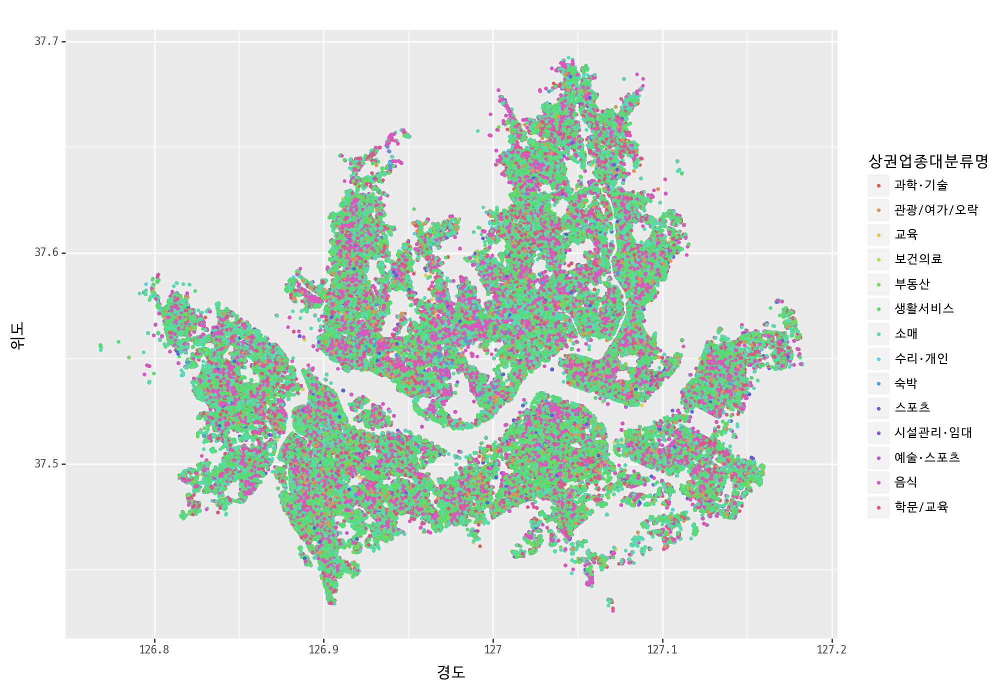

<Figure Size: (1000 x 700)>

In [28]:
(
    ggplot(shop_seoul, aes(x='경도', y='위도', color='상권업종대분류명'))
        + geom_point(size=0.5)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
        + scale_fill_gradient(low='blue', high='green')
)

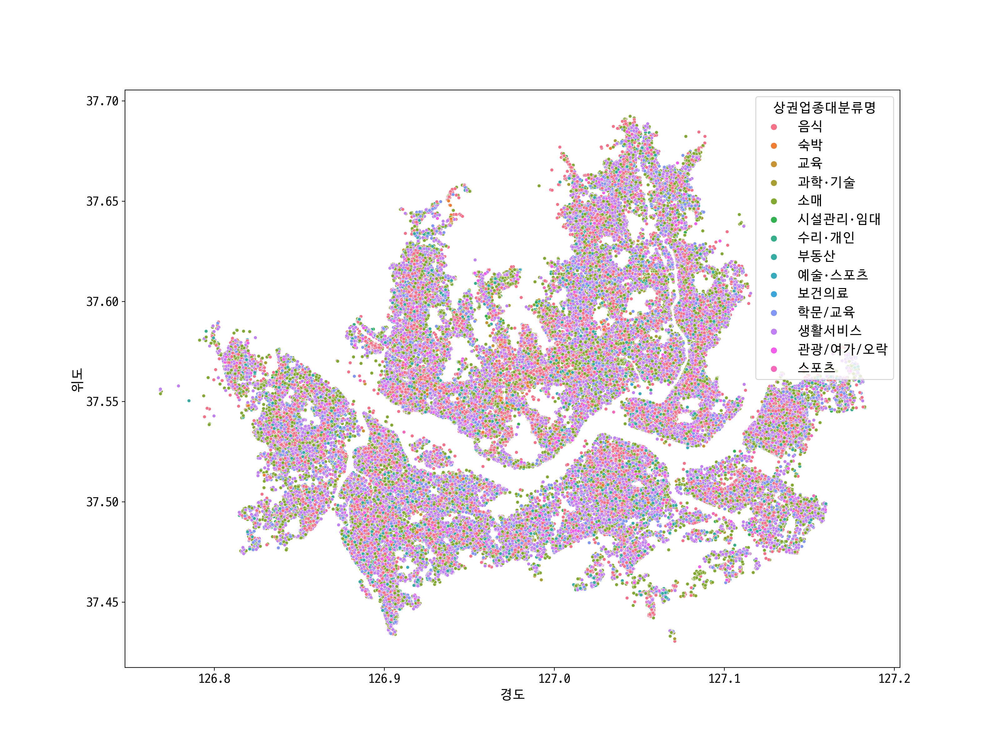

In [29]:
plt.figure(figsize=(16, 12))
sns.scatterplot(data=shop_seoul, x='경도', y='위도', hue='상권업종대분류명', s=15)
plt.show()

학문/교육과 관련된 정보 보기

In [30]:
shop_seoul_edu = shop_seoul[shop_seoul.상권업종대분류명 == '학문/교육']
shop_seoul_edu

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도,시도,구군,도로명
489906,김선희꼼꼼국어교습소,NaN,학문/교육,학원-보습교습입시,학원-입시,서울특별시,송파구,방이1동,방이동,서울특별시 송파구 방이동 197-3,서울특별시 송파구 위례성대로12길 31,127.121520,37.510967,서울특별시,송파구,위례성대로12길
489911,무비디자인,NaN,학문/교육,학원-창업취업취미,학원-디자인,서울특별시,마포구,대흥동,노고산동,서울특별시 마포구 노고산동 107-17,서울특별시 마포구 백범로 8,126.936717,37.553996,서울특별시,마포구,백범로
489921,힐리빙텔,NaN,학문/교육,도서관/독서실,독서실,서울특별시,서대문구,신촌동,대현동,서울특별시 서대문구 대현동 37-69,서울특별시 서대문구 이화여대5길 28,126.944057,37.558414,서울특별시,서대문구,이화여대5길
489922,김샘수학교습소,NaN,학문/교육,학원-보습교습입시,학원-입시,서울특별시,중구,신당5동,신당동,서울특별시 중구 신당동 851,서울특별시 중구 퇴계로90길 74,127.020965,37.560996,서울특별시,중구,퇴계로90길
489946,노바수학학원,NaN,학문/교육,학원-보습교습입시,학원-입시,서울특별시,강남구,일원2동,개포동,서울특별시 강남구 개포동 12-4,서울특별시 강남구 개포로 615,127.075573,37.492649,서울특별시,강남구,개포로
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867519,젬마에듀케이션,NaN,학문/교육,학원기타,학원(종합),서울특별시,노원구,월계3동,월계동,서울특별시 노원구 월계동 18,서울특별시 노원구 마들로 31,127.068175,37.617387,서울특별시,노원구,마들로
867522,헤어앤에스엠피,NaN,학문/교육,학원-어학,학원-외국어/어학,서울특별시,동대문구,장안2동,장안동,서울특별시 동대문구 장안동 302-1,서울특별시 동대문구 장한로 181,127.071751,37.576634,서울특별시,동대문구,장한로
867538,학원,꿈의숲음악,학문/교육,학원-음악미술무용,피아노/바이올린/기타,서울특별시,강북구,번3동,번동,서울특별시 강북구 번동 308-3,서울특별시 강북구 오현로34길 12,127.040018,37.628595,서울특별시,강북구,오현로34길
867544,트레저애드,NaN,학문/교육,학원-예능취미체육,레크레이션지도/상담,서울특별시,종로구,무악동,무악동,서울특별시 종로구 무악동 82,서울특별시 종로구 통일로 246-20,126.962054,37.577072,서울특별시,종로구,통일로


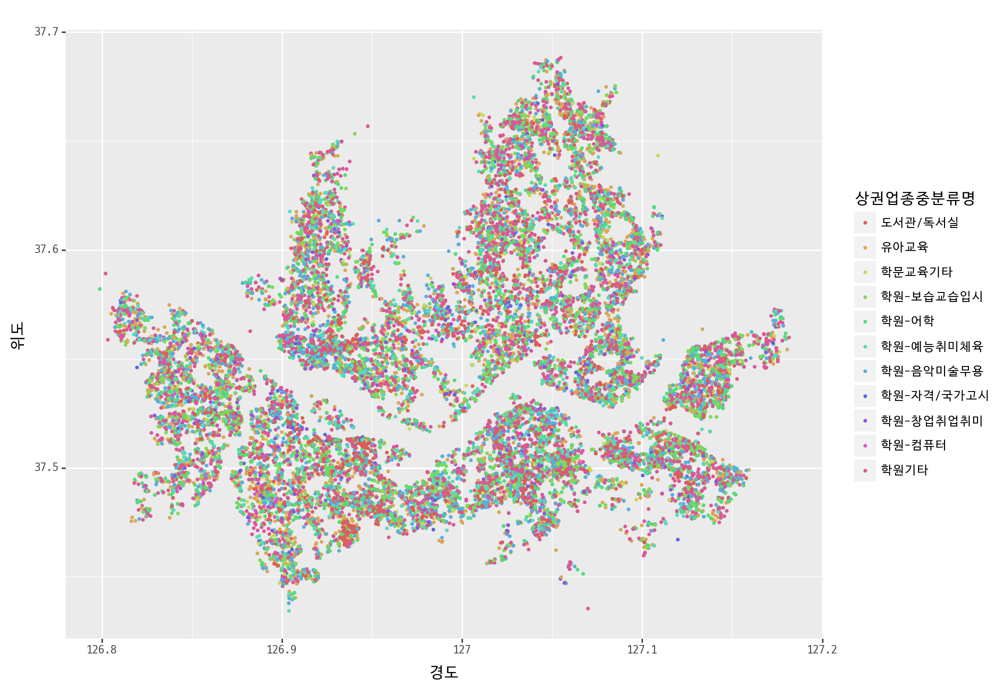

<Figure Size: (1000 x 700)>

In [31]:
(
    ggplot(shop_seoul_edu, aes(x='경도', y='위도', color='상권업종중분류명'))
        + geom_point(size=0.5)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
        + scale_fill_gradient(low='blue', high='green')
)

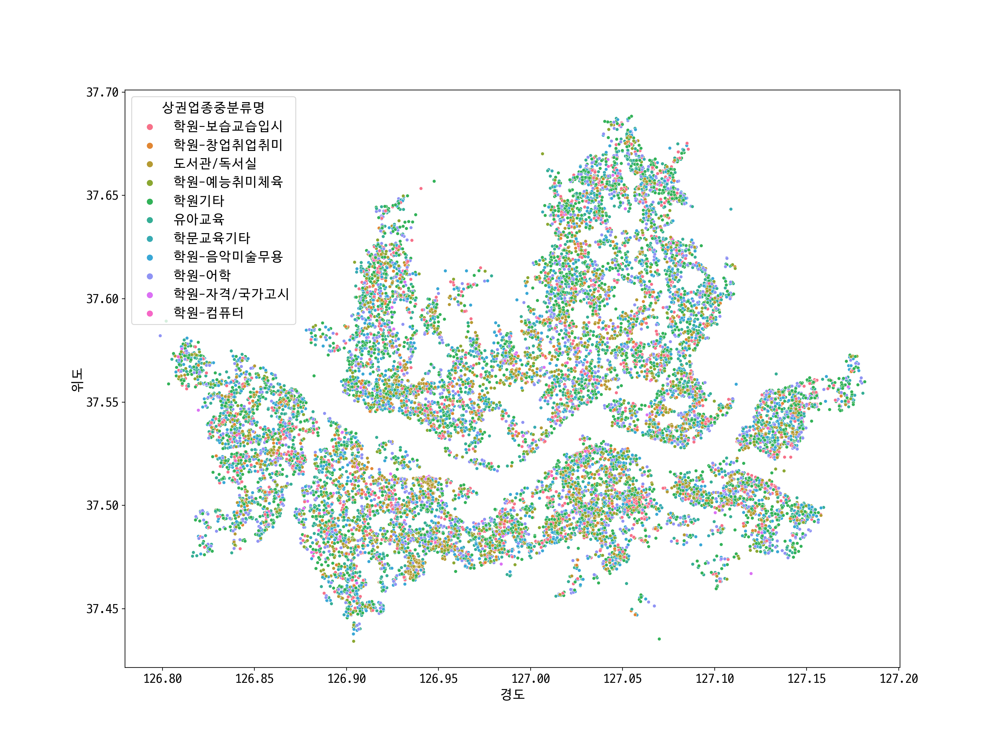

In [32]:
plt.figure(figsize=(16, 12))
sns.scatterplot(data=shop_seoul_edu, x='경도', y='위도', hue='상권업종중분류명', s=15)
plt.show()

부동산과 관련된 정보 보기

In [33]:
shop_seoul_realty = shop_seoul[shop_seoul.상권업종대분류명 == '부동산']
shop_seoul_realty

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도,시도,구군,도로명
23,나루공인중개사사무소,NaN,부동산,부동산 서비스,부동산 중개/대리업,서울특별시,강남구,역삼1동,역삼동,서울특별시 강남구 역삼동 702-10,서울특별시 강남구 테헤란로 311,127.044843,37.503740,서울특별시,강남구,테헤란로
25,119래미안로이파크공인중개사사무소,NaN,부동산,부동산 서비스,부동산 중개/대리업,서울특별시,동작구,사당3동,사당동,서울특별시 동작구 사당동 1159,서울특별시 동작구 사당로23길 112,126.973457,37.487788,서울특별시,동작구,사당로23길
52,동인공인중개사사무소,NaN,부동산,부동산 서비스,부동산 중개/대리업,서울특별시,관악구,대학동,신림동,서울특별시 관악구 신림동 1515-16,서울특별시 관악구 신림로 119,126.936045,37.470688,서울특별시,관악구,신림로
144,더빌딩부동산중개법인,NaN,부동산,부동산 서비스,부동산 중개/대리업,서울특별시,강남구,삼성2동,삼성동,서울특별시 강남구 삼성동 143-37,서울특별시 강남구 테헤란로 423,127.053045,37.506212,서울특별시,강남구,테헤란로
178,시트러스에셋,NaN,부동산,부동산 서비스,부동산 중개/대리업,서울특별시,서초구,반포1동,반포동,서울특별시 서초구 반포동 736-2,서울특별시 서초구 강남대로85길 5,127.022582,37.507361,서울특별시,서초구,강남대로85길
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867569,헤스티아에이블,NaN,부동산,분양,건물분양-종합,서울특별시,은평구,진관동,진관동,서울특별시 은평구 진관동 100-1,서울특별시 은평구 통일로 1022,126.917726,37.633790,서울특별시,은평구,통일로
867576,아르스헥사프리포트인천공항피에프브이,NaN,부동산,분양,건물분양-종합,서울특별시,강남구,청담동,청담동,서울특별시 강남구 청담동 129-3,서울특별시 강남구 도산대로 549,127.053931,37.525637,서울특별시,강남구,도산대로
867580,수건축,NaN,부동산,분양,주택공급,서울특별시,노원구,상계1동,상계동,서울특별시 노원구 상계동 1098-21,서울특별시 노원구 동일로239나길 36,127.051699,37.676688,서울특별시,노원구,동일로239나길
867618,바른가족경매,NaN,부동산,분양,건물분양-종합,서울특별시,금천구,가산동,가산동,서울특별시 금천구 가산동 371-28,서울특별시 금천구 가산디지털1로 168,126.882626,37.479953,서울특별시,금천구,가산디지털1로


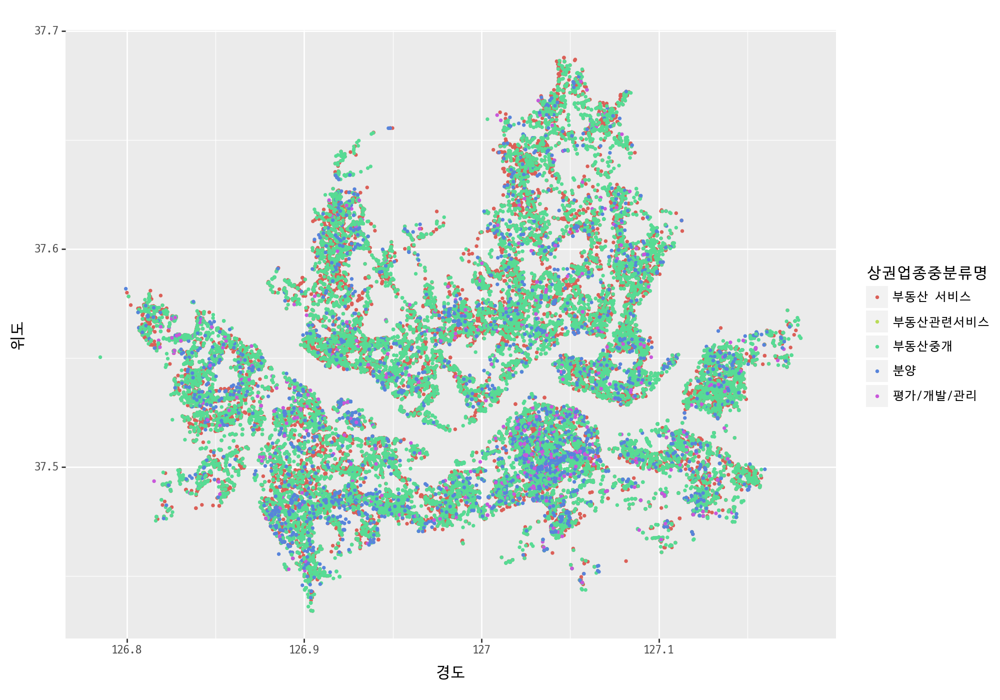

<Figure Size: (1000 x 700)>

In [34]:
(
    ggplot(shop_seoul_realty, aes(x='경도', y='위도', color='상권업종중분류명'))
        + geom_point(size=0.5)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
        + scale_fill_gradient(low='blue', high='green')
)

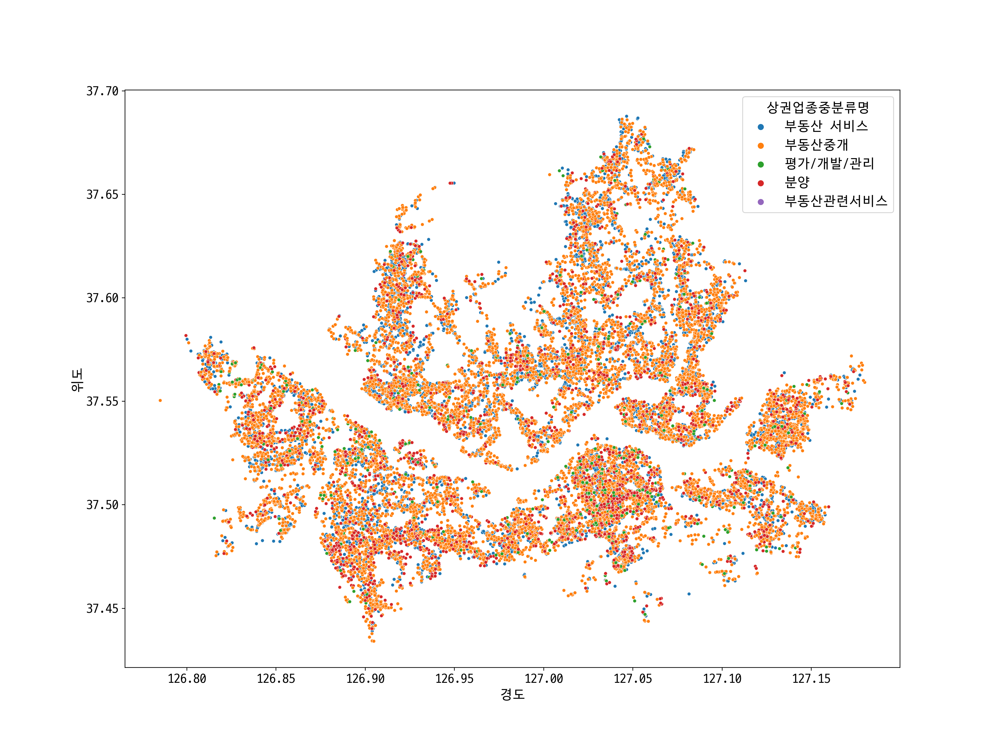

In [35]:
plt.figure(figsize=(16, 12))
sns.scatterplot(data=shop_seoul_realty, x='경도', y='위도', hue='상권업종중분류명', s=15)
plt.show()

컴퓨터 학원과 관련된 정보 보기

In [36]:
set(shop_seoul_edu.상권업종중분류명)

{'도서관/독서실',
 '유아교육',
 '학문교육기타',
 '학원-보습교습입시',
 '학원-어학',
 '학원-예능취미체육',
 '학원-음악미술무용',
 '학원-자격/국가고시',
 '학원-창업취업취미',
 '학원-컴퓨터',
 '학원기타'}

In [37]:
shop_seoul_edu_computer = shop_seoul_edu[shop_seoul_edu.상권업종중분류명 == '학원-컴퓨터']
shop_seoul_edu_computer

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도,시도,구군,도로명
494823,진원컴퓨터학원,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,양천구,신월5동,신월동,서울특별시 양천구 신월동 28-6,서울특별시 양천구 화곡로 41,126.826484,37.539544,서울특별시,양천구,화곡로
495610,대성컴퓨터회계학원,대성컴퓨터회계,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,관악구,인헌동,봉천동,서울특별시 관악구 봉천동 1657-24,서울특별시 관악구 남부순환로 1952,126.965659,37.475943,서울특별시,관악구,남부순환로
497040,구로컴퓨터학원,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,금천구,시흥1동,시흥동,서울특별시 금천구 시흥동 870-10,서울특별시 금천구 시흥대로 266,126.899903,37.457508,서울특별시,금천구,시흥대로
503864,아몬정보컴퓨터학원,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,중랑구,중화1동,중화동,서울특별시 중랑구 중화동 290-5,서울특별시 중랑구 동일로130길 39,127.082118,37.599980,서울특별시,중랑구,동일로130길
505444,구미컴퓨터학원,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,강남구,역삼1동,역삼동,서울특별시 강남구 역삼동 816-3,서울특별시 강남구 강남대로 416,127.027137,37.499793,서울특별시,강남구,강남대로
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
839056,학원,잼코딩서초,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,서초구,서초1동,서초동,서울특별시 서초구 서초동 1603-9,서울특별시 서초구 서초중앙로 40-6,127.016443,37.485648,서울특별시,서초구,서초중앙로
843311,메타코딩컴퓨터교습소,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,양천구,신월4동,신월동,서울특별시 양천구 신월동 439-16,서울특별시 양천구 오목로 19,126.839661,37.521645,서울특별시,양천구,오목로
844768,네오락,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,서초구,반포1동,반포동,서울특별시 서초구 반포동 745,서울특별시 서초구 사평대로 335,127.019591,37.503452,서울특별시,서초구,사평대로
857187,휴몬랩코딩아카데미,NaN,학문/교육,학원-컴퓨터,컴퓨터학원,서울특별시,강남구,압구정동,신사동,서울특별시 강남구 신사동 609-6,서울특별시 강남구 압구정로32길 24,127.029759,37.526171,서울특별시,강남구,압구정로32길


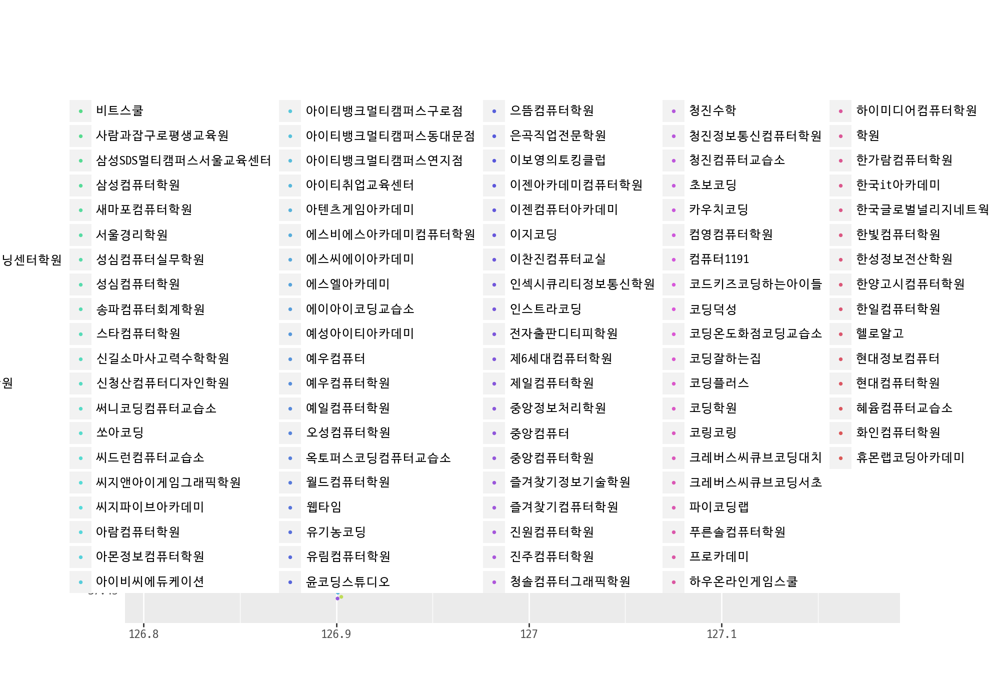

<Figure Size: (1000 x 700)>

In [38]:
(
    ggplot(shop_seoul_edu_computer, aes(x='경도', y='위도', color='상호명'))
        + geom_point(size=0.5)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
        + scale_fill_gradient(low='blue', high='green')
)

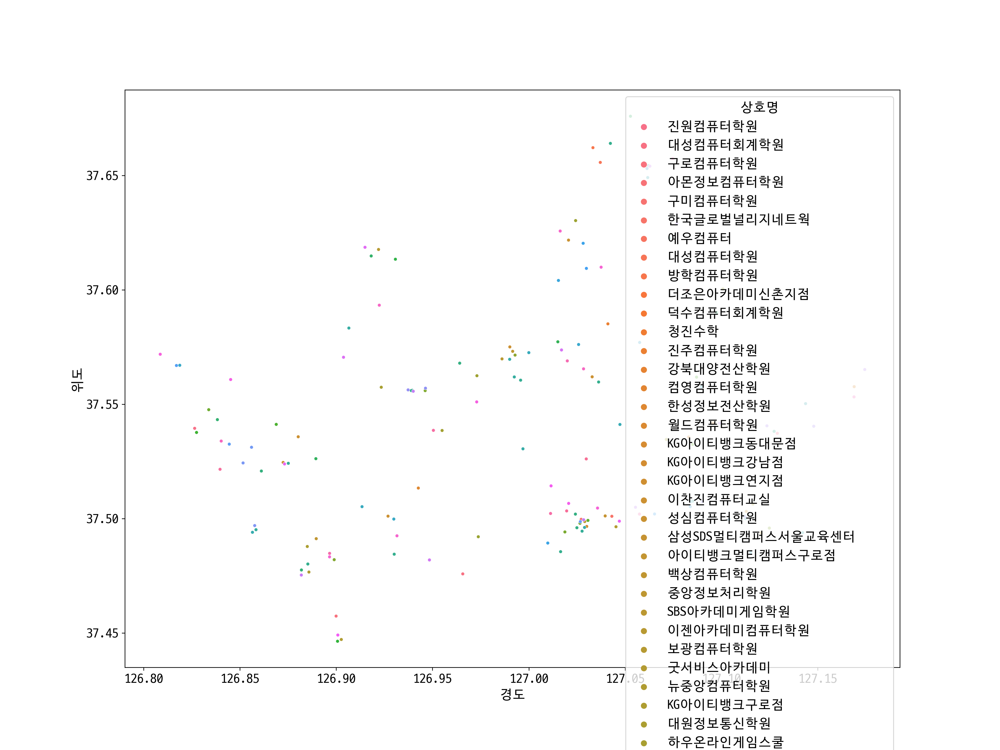

In [39]:
plt.figure(figsize=(16, 12))
sns.scatterplot(data=shop_seoul_edu_computer, x='경도', y='위도', hue='상호명', s=15)
plt.show()

folium Map 컴퓨터 학원 위치 시각화

In [40]:
import folium

In [41]:
data = shop_seoul_edu_computer
edu_map = folium.Map(location=[data.위도.mean(), data.경도.mean()], zoom_start=12, tiles='Stamen Terrain')

'''
# iterrows() 메소드는 index와 데이터를 튜플 형태로 리턴한다.
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.Marker(location=[edu.위도, edu.경도], popup=popup).add_to(edu_map)
'''

for i in data.index:
    popup = folium.Popup('{}: {}'.format(data.loc[i, '상호명'], data.loc[i, '도로명주소']), max_width=300)
    folium.Marker(location=[data.loc[i, '위도'], data.loc[i, '경도']], popup=popup).add_to(edu_map)

edu_map.save('./output/edu_map.html')
edu_map

커피점/카페 시각화

In [42]:
set(shop_seoul.상권업종중분류명)

{'PC/오락/당구/볼링등',
 '가구 소매',
 '가구소매',
 '가방/신발/액세서리',
 '가전·통신 소매',
 '가전제품 수리',
 '가전제품소매',
 '가정/주방/인테리어',
 '가정용품 대여',
 '개인/가정용품수리',
 '개인서비스',
 '건강/미용식품',
 '경마/경륜/성인오락',
 '고용 알선',
 '광고',
 '광고/인쇄',
 '교육 지원',
 '구내식당·뷔페',
 '기술 서비스',
 '기타 가정용품 수리',
 '기타 간이',
 '기타 개인',
 '기타 교육',
 '기타 보건',
 '기타 사업 서비스',
 '기타 상품 소매',
 '기타 생활용품 소매',
 '기타 숙박',
 '기타 외국',
 '기타 전문 과학',
 '기타서비스업',
 '기타음식업',
 '기타판매업',
 '놀이/여가/취미',
 '닭/오리요리',
 '담배 소매',
 '대중목욕탕/휴게',
 '대행업',
 '도서관/독서실',
 '도서관·사적지',
 '동남아시아',
 '모터사이클 소매',
 '모터사이클 수리',
 '모텔/여관/여인숙',
 '무도/유흥/가무',
 '물품기기대여',
 '민박/하숙',
 '법무관련 ',
 '법무세무회계',
 '별식/퓨전요리',
 '병원',
 '본사·경영 컨설팅',
 '부동산 서비스',
 '부동산관련서비스',
 '부동산중개',
 '부페',
 '분식',
 '분양',
 '비알코올 ',
 '사무 지원',
 '사무/문구/컴퓨터',
 '사진',
 '사진 촬영',
 '사진/광학/정밀기기소매',
 '산업용품 대여',
 '서양식',
 '선물/팬시/기념품',
 '섬유·의복·신발 소매',
 '세탁',
 '세탁/가사서비스',
 '수의',
 '스포츠 서비스',
 '스포츠/운동',
 '시계/귀금속소매',
 '시계·귀금속 소매',
 '시설관리',
 '시장 조사',
 '식료품 소매',
 '식물 소매',
 '실내운동시설',
 '실외운동시설',
 '안경·정밀기기 소매',
 '애견/애완/동물',
 '애완동물·용품 소매',
 '양식',
 '여행사·보조',
 '연극/영화/극장',
 '연료 소매',


In [43]:
shop_seoul_cafe = shop_seoul[shop_seoul.상권업종중분류명 == '커피점/카페']
shop_seoul_cafe

,상호명,지점명,상권업종대분류명,상권업종중분류명,상권업종소분류명,시도명,시군구명,행정동명,법정동명,지번주소,도로명주소,경도,위도,시도,구군,도로명
489923,커피빈,코리아대학로대명거리점,음식,커피점/카페,커피전문점/카페/다방,서울특별시,종로구,혜화동,명륜4가,서울특별시 종로구 명륜4가 51,서울특별시 종로구 대명길 25,127.000171,37.583149,서울특별시,종로구,대명길
489999,요거프레소,쌍문점,음식,커피점/카페,커피전문점/카페/다방,서울특별시,도봉구,쌍문2동,쌍문동,서울특별시 도봉구 쌍문동 20,서울특별시 도봉구 도당로 7,127.034746,37.658728,서울특별시,도봉구,도당로
490092,우성커피숍,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,양천구,신월4동,신월동,서울특별시 양천구 신월동 514-2,서울특별시 양천구 오목로 48,126.842935,37.522055,서울특별시,양천구,오목로
490099,버블베어,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,강서구,방화3동,방화동,서울특별시 강서구 방화동 819,서울특별시 강서구 금낭화로 167,126.813358,37.580941,서울특별시,강서구,금낭화로
490135,알뤼르,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,강남구,대치4동,대치동,서울특별시 강남구 대치동 894,서울특별시 강남구 삼성로85길 33,127.054731,37.504378,서울특별시,강남구,삼성로85길
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
867585,힐리HILLI,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,서초구,잠원동,잠원동,서울특별시 서초구 잠원동 61-7,서울특별시 서초구 잠원로4길 41-3,127.010938,37.512931,서울특별시,서초구,잠원로4길
867596,월성맨션,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,마포구,상암동,상암동,서울특별시 마포구 상암동 1607,서울특별시 마포구 상암산로 76,126.892296,37.579186,서울특별시,마포구,상암산로
867604,덩키카페,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,강남구,삼성2동,삼성동,서울특별시 강남구 삼성동 141,서울특별시 강남구 선릉로 514,127.049151,37.505595,서울특별시,강남구,선릉로
867606,감화커피,NaN,음식,커피점/카페,커피전문점/카페/다방,서울특별시,강서구,화곡8동,화곡동,서울특별시 강서구 화곡동 333-27,서울특별시 강서구 강서로18가길 44,126.846106,37.535791,서울특별시,강서구,강서로18가길


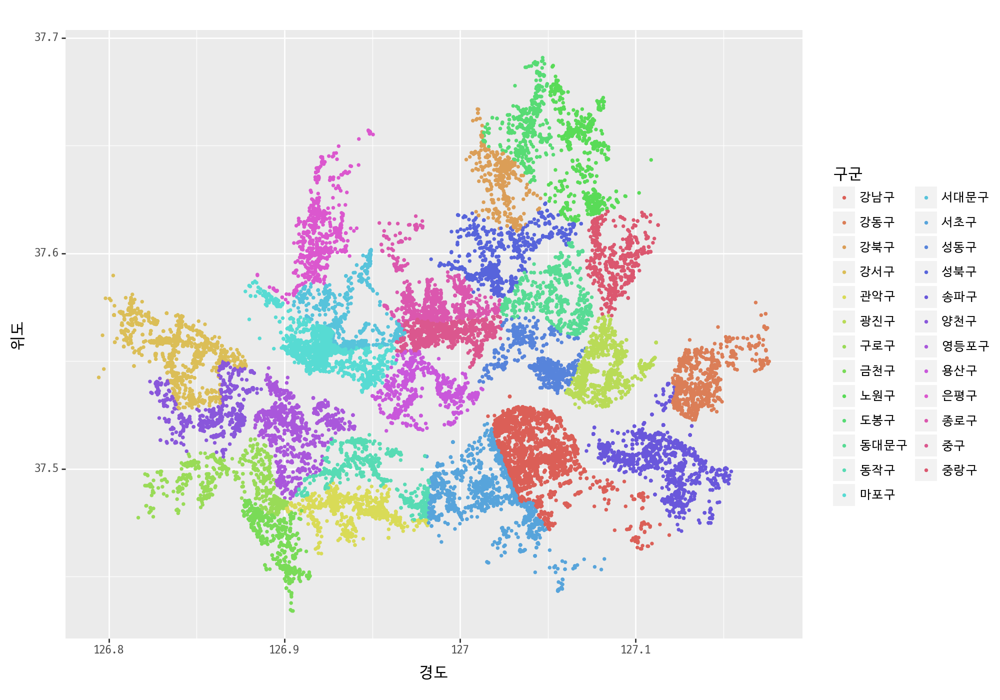

<Figure Size: (1000 x 700)>

In [44]:
(
    ggplot(shop_seoul_cafe, aes(x='경도', y='위도', color='구군'))
        + geom_point(size=0.5)
        + theme(text=element_text(family='D2Coding'), figure_size=(10, 7))
        + scale_fill_gradient(low='blue', high='green')
)

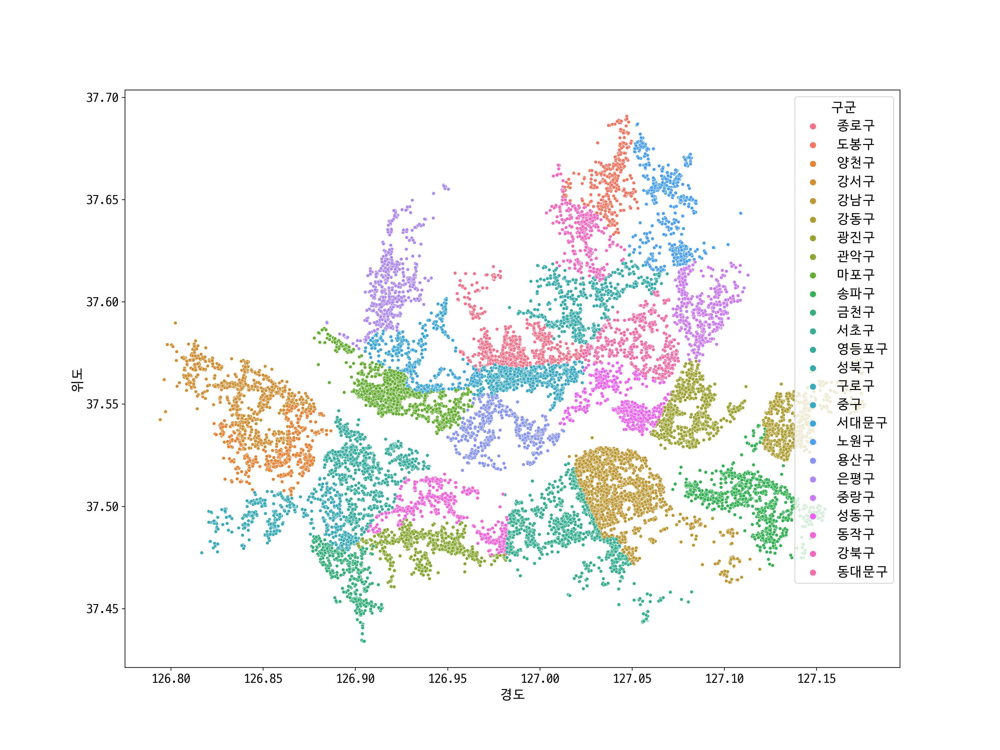

In [45]:
plt.figure(figsize=(16, 12))
sns.scatterplot(data=shop_seoul_cafe, x='경도', y='위도', hue='구군', s=15)
plt.show()

이디야, 스타벅스 시각화

In [46]:
data = shop_seoul_cafe[shop_seoul_cafe.상호명.str.find('이디야') >= 0]
cafe_map = folium.Map(location=[data.위도.mean(), data.경도.mean()], zoom_start=12)
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='blue').add_to(cafe_map)

data = shop_seoul_cafe[shop_seoul_cafe.상호명.str.find('스타벅스') >= 0]
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='red').add_to(cafe_map)

cafe_map.save('./output/cafe_map.html')
cafe_map

베스킨라빈스, 던킨도너츠 시각화

In [47]:
data = shop_seoul[shop_seoul.상호명.str.find('스킨라빈스') >= 0]
cafe_map = folium.Map(location=[data.위도.mean(), data.경도.mean()], zoom_start=12)
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='blue').add_to(cafe_map)

data = shop_seoul[shop_seoul.상호명.str.find('던킨') >= 0]
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='red').add_to(cafe_map)

cafe_map.save('./output/cafe_map.html')
cafe_map

파리바게뜨, 뚜레쥬르

In [48]:
data = shop_seoul[shop_seoul.상호명.str.find('파리바게뜨') >= 0]
cafe_map = folium.Map(location=[data.위도.mean(), data.경도.mean()], zoom_start=12)
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='blue').add_to(cafe_map)

data = shop_seoul[shop_seoul.상호명.str.find('뚜레쥬르') >= 0]
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='red').add_to(cafe_map)

cafe_map.save('./output/cafe_map.html')
cafe_map

빽다방, 메가커피

In [49]:
data = shop_seoul[shop_seoul.상호명.str.find('빽다방') >= 0]
cafe_map = folium.Map(location=[data.위도.mean(), data.경도.mean()], zoom_start=12)
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='blue').add_to(cafe_map)

data = shop_seoul[shop_seoul.상호명.str.find('메가커피') >= 0]
for _, edu in data.iterrows():
    popup = folium.Popup('{}: {}'.format(edu.상호명, edu.도로명주소), max_width=300)
    folium.CircleMarker(location=[edu.위도, edu.경도], popup=popup, radius=2, color='red').add_to(cafe_map)

cafe_map.save('./output/cafe_map.html')
cafe_map

구군별 커피점/카페수 시각화

In [50]:
shop_seoul_cafe_count = shop_seoul_cafe.groupby('구군').상호명.count()
shop_seoul_cafe_count.head()

구군
강남구    2262
강동구     786
강북구     395
강서구    1157
관악구     755
Name: 상호명, dtype: int64

In [51]:
shop_seoul_cafe_lat = shop_seoul_cafe.groupby('구군').위도.mean()
shop_seoul_cafe_lat.head()

구군
강남구    37.506266
강동구    37.542181
강북구    37.632614
강서구    37.555494
관악구    37.480558
Name: 위도, dtype: float64

In [52]:
shop_seoul_cafe_lot = shop_seoul_cafe.groupby('구군').경도.mean()
shop_seoul_cafe_lot.head()

구군
강남구    127.044577
강동구    127.139299
강북구    127.023387
강서구    126.838198
관악구    126.939574
Name: 경도, dtype: float64

In [53]:
shop_seoul_cafe_concat = pd.concat([shop_seoul_cafe_count, shop_seoul_cafe_lat, shop_seoul_cafe_lot], axis=1)
shop_seoul_cafe_concat.columns = ['매장수', '위도', '경도']
shop_seoul_cafe_concat

,매장수,위도,경도
구군,,,
강남구,2262,37.506266,127.044577
강동구,786,37.542181,127.139299
강북구,395,37.632614,127.023387
강서구,1157,37.555494,126.838198
관악구,755,37.480558,126.939574
광진구,866,37.546073,127.081245
구로구,609,37.494695,126.870924
금천구,523,37.468778,126.892863
노원구,634,37.644810,127.069257


In [54]:
data = shop_seoul_cafe_concat
cafe_map = folium.Map(location=[data.위도.mean(), data.경도.mean()], zoom_start=12)

for index, cafe in data.iterrows():
    popup = folium.Popup('{}: {:,.0f}'.format(index, cafe.매장수), max_width=300)
    folium.CircleMarker(location=[cafe.위도, cafe.경도], popup=popup, radius=cafe.매장수 / 40, 
                        color='red',fill_color='blue').add_to(cafe_map)

cafe_map.save('./output/cafe_map.html')
cafe_map